# With LLMs

In [ ]:
!pip install -q transformers accelerate bitsandbytes shap

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 547.9/547.9 kB 6.9 MB/s eta 0:00:00


In [ ]:
import numpy as np
from transformers import AutoTokenizer, AutoModelForCausalLM
import shap
import torch

In [ ]:
tokenizer = AutoTokenizer.from_pretrained("gpt2", use_fast=True)
model = AutoModelForCausalLM.from_pretrained("gpt2").cuda()

In [ ]:
# set model decoder to true
model.config.is_decoder=True
# set text-generation params under task_specific_params
model.config.task_specific_params["text-generation"] = {
    "do_sample": True,
    "max_length": 50,
    "temperature": 0.7,
    "top_k": 50,
    "no_repeat_ngram_size": 2
}

In [ ]:
s = ['I enjoy walking with my cute dog']

In [ ]:
explainer = shap.Explainer(model, tokenizer)
shap_values = explainer(s)

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.
Partition explainer: 2it [00:15, 15.66s/it]               


In [ ]:
shap.plots.text(shap_values)

In [ ]:
s = ['Scientists confirmed the worst possible outcome: the massive asteroid will collide with Earth']

explainer = shap.Explainer(model, tokenizer)
shap_values = explainer(s)

shap.plots.text(shap_values)

Setting `pad_token_id` to `eos_token_id`:50256 for open-end generation.
Using the model-agnostic default `max_length` (=20) to control thegeneration length. We recommend setting `max_new_tokens` to control the maximum length of the generation.


In [ ]:
# define input
x = [
    "I know many people who are Russian.",
    "I know many people who are Greek.",
    "I know many people who are Australian.",
    "I know many people who are American.",
    "I know many people who are Italian.",
    "I know many people who are Spanish.",
    "I know many people who are German.",
    "I know many people who are Indian."
]

# define output
y = [
    "They love their vodka!",
    "They love their vodka!",
    "They love their vodka!",
    "They love their vodka!",
    "They love their vodka!",
    "They love their vodka!",
    "They love their vodka!",
    "They love their vodka!"
]

teacher_forcing_model = shap.models.TeacherForcing(model, tokenizer)
masker = shap.maskers.Text(tokenizer, mask_token = "...", collapse_mask_token=True)

In [ ]:
explainer = shap.Explainer(teacher_forcing_model, masker)
shap_values = explainer(x, y)


In [ ]:
shap.plots.text(shap_values)

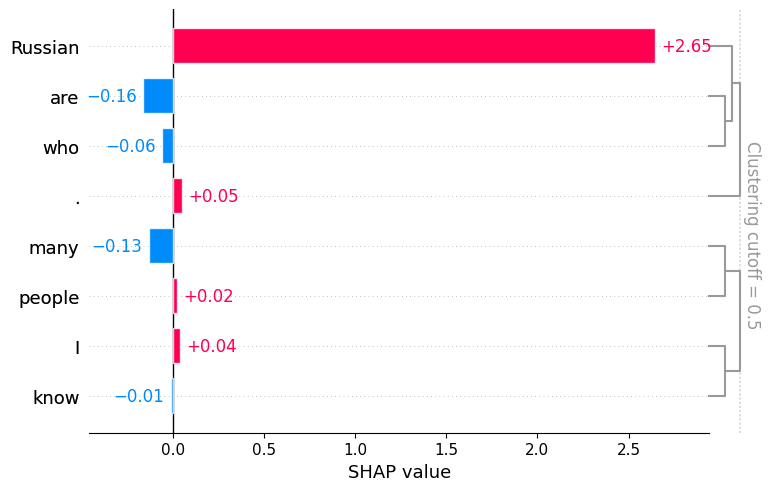

In [ ]:
shap.plots.bar(shap_values[0, :, "vodka"])

# Text to Multiclass Explanation

In [ ]:
tokenizer = AutoTokenizer.from_pretrained('gpt2', use_fast=True)
model = AutoModelForCausalLM.from_pretrained('gpt2').cuda()

In [ ]:
wrapped_model = shap.models.TopKLM(model, tokenizer, k=100)
masker = shap.maskers.Text(tokenizer, mask_token = "...", collapse_mask_token=True)

In [ ]:
s = ["In a shocking finding, scientists discovered a herd of unicorns living in a"]
explainer = shap.Explainer(wrapped_model, masker)
shap_values = explainer(s)

In [ ]:
shap.plots.text(shap_values)

# Explaining Topic Word Inclusions

In [ ]:
tokenizer = AutoTokenizer.from_pretrained('gpt2', use_fast=True)
model = AutoModelForCausalLM.from_pretrained('gpt2').cuda()

In [ ]:
# define input
x = [
    """
    From: lerxst@wam.umd.edu (where's my thing)\nSubject: WHAT car is this!?\nNntp-Posting-Host: rac3.wam.umd.edu\nOrganization: University of Maryland, College Park\nLines: 15\n\n I was wondering if anyone out there could enlighten me on this car I saw\nthe other day. It was a 2-door sports car, looked to be from the late 60s/\nearly 70s. It was called a Bricklin. The doors were really small. In addition,\nthe front bumper was separate from the rest of the body. This is \nall I know. If anyone can tellme a model name, engine specs, years\nof production, where this car is made, history, or whatever info you\nhave on this funky looking car, please e-mail.\n\nThanks,\n- IL\n   ---- brought to you by your neighborhood Lerxst ----\n\n\n\n\n
    The above text is summarized by the following topic keyword :
    """
]

# define output
y = [
    "Sports car, Query on Cars, Seeking Help"
]

teacher_forcing_model = shap.models.TeacherForcing(model, tokenizer)
masker = shap.maskers.Text(tokenizer, mask_token = "...", collapse_mask_token=True)

  0%|          | 0/498 [00:00<?, ?it/s]

Partition explainer: 2it [00:33, 33.52s/it]               


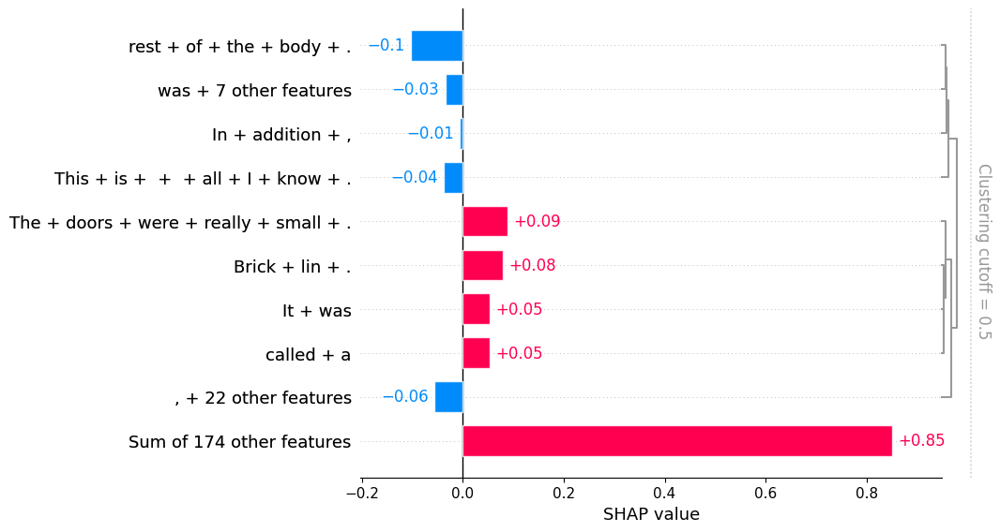

In [ ]:
explainer = shap.Explainer(teacher_forcing_model, masker)
shap_values = explainer(x, y)
shap.plots.text(shap_values)
shap.plots.bar(shap_values[0, :, "Cars"])

#